In [4]:
import functions 
import os


times = ["2013", "2014", "2015", "2016", "2017", "2018", "2019", "2020", "2021"]
#times = ["2013", "2014", "2015", "2016", "2017"]
fullData = []

# change path 
os.chdir("/media/jonas/B41ED7D91ED792AA/Arbeit_und_Studium/Kognitionswissenschaft/Semester_5/masterarbeit#/repo")
path = os.getcwd() + "/images"
os.chdir(path)

for i in range(len(times)):
    helper = functions.openData(times[i])
    fullData.append(helper)

In [6]:
data = [item for sublist in fullData for item in sublist]
len(data)

117

In [3]:
data[1][1].shape

(712, 856, 6)

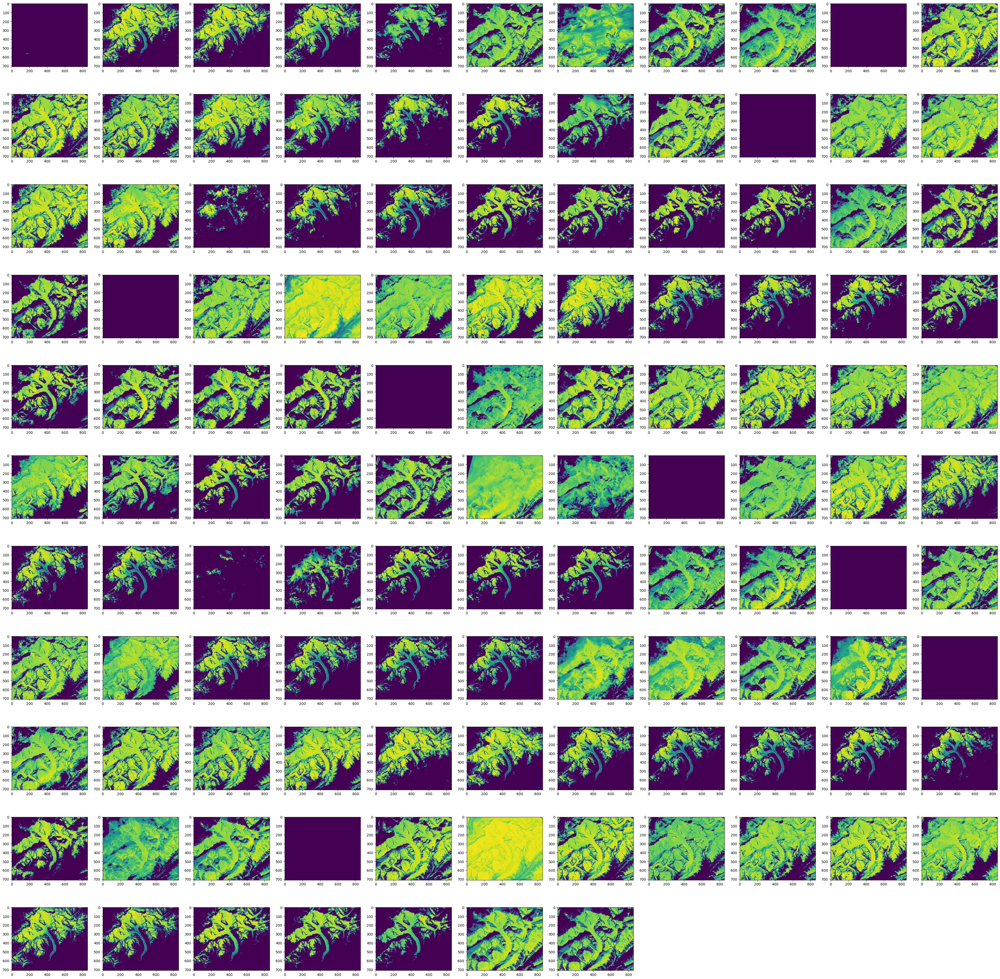

In [5]:
# plot snow/ice change over time
import matplotlib.pyplot as plt
plt.figure(figsize=(50, 50)) 
import matplotlib.pyplot as plt
for i in range(len(data)):
    plt.subplot(11,11,i+1)
    plt.imshow(data[i][1][:,:,5])

In [9]:
import numpy as np
snowPix = list(map(lambda x: np.sum(np.ndarray.flatten(x[1][:,:,5])), data))

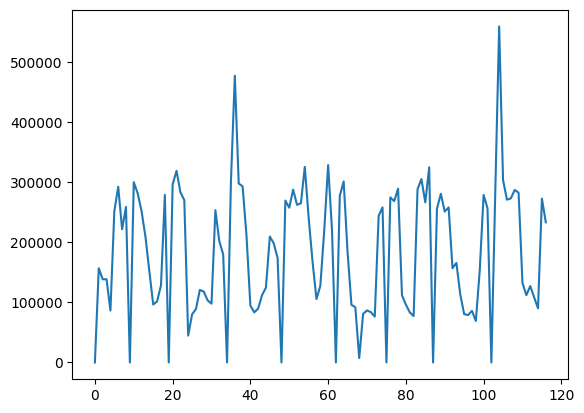

In [29]:
import matplotlib.pyplot as plt
plt.plot(snowPix)

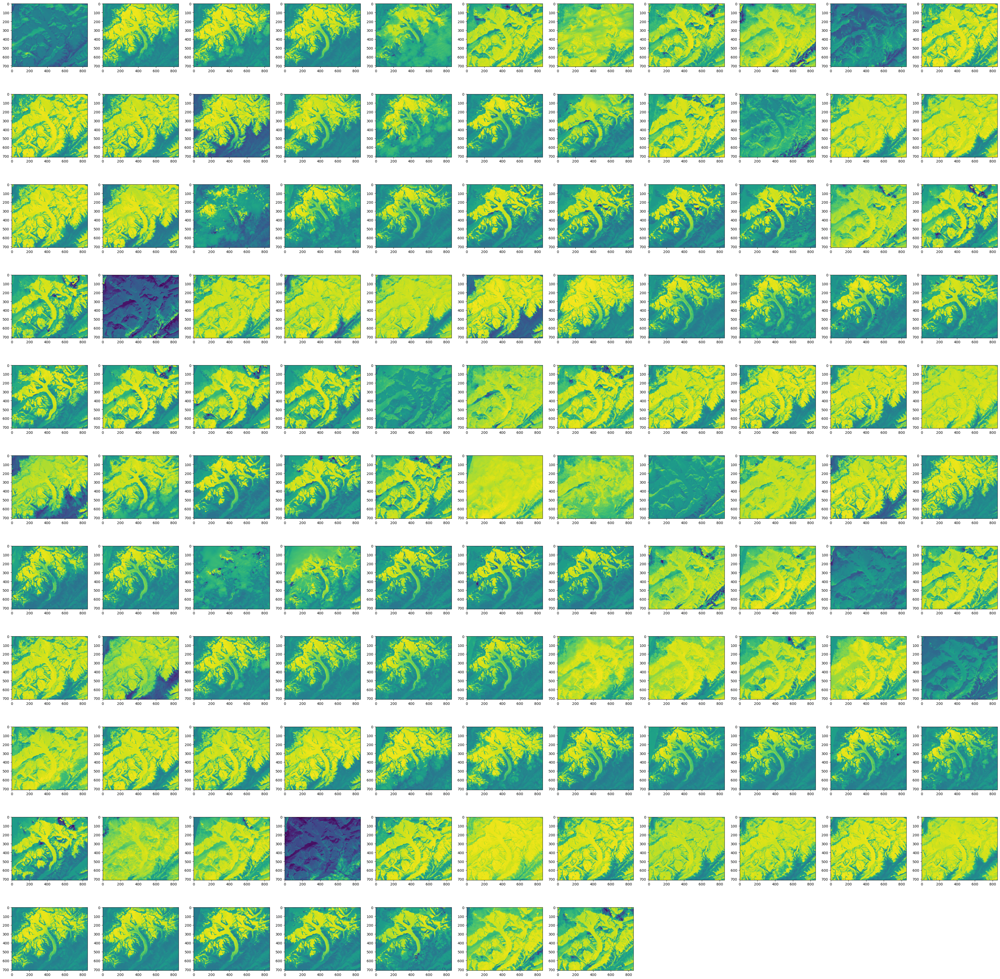

In [6]:
# plot snow/ice change over time
import matplotlib.pyplot as plt
plt.figure(figsize=(50, 50)) 
import matplotlib.pyplot as plt
for i in range(len(data)):
    plt.subplot(11,11,i+1)
    plt.imshow(data[i][1][:,:,3])

In [7]:
import numpy as np
times = []
for i in range(len(data)):
    helper = str(data[i][0])
    year = int(helper[0:4])
    month = int(helper[5:7])
    day = int(helper[8:10])
    res = np.array([year, month, day])
    times.append(res)
    
dates = np.vstack(times)
print(dates)
    

[[2013    4   18]
 [2013    7   16]
 [2013    7   23]
 [2013    8    1]
 [2013    9    9]
 [2013   11   12]
 [2013   11   28]
 [2013   12    7]
 [2013   12   30]
 [2014    1   15]
 [2014    3   13]
 [2014    3   20]
 [2014    4   14]
 [2014    6    8]
 [2014    7    3]
 [2014    8    4]
 [2014    9   28]
 [2014   10   30]
 [2015    2   12]
 [2015    2   19]
 [2015    3   23]
 [2015    4    8]
 [2015    4   24]
 [2015    5   10]
 [2015    7    6]
 [2015    8    7]
 [2015    8   30]
 [2015   10   26]
 [2015   11    2]
 [2015   11   11]
 [2015   11   18]
 [2015   11   27]
 [2015   12   20]
 [2015   12   29]
 [2016    1   21]
 [2016    3   18]
 [2016    4   10]
 [2016    4   19]
 [2016    5   21]
 [2016    6   22]
 [2016    8   25]
 [2016    9    1]
 [2016    9   26]
 [2016   10    3]
 [2016   10   12]
 [2016   12    6]
 [2016   12   22]
 [2016   12   31]
 [2017    1    7]
 [2017    1   16]
 [2017    1   23]
 [2017    3   28]
 [2017    4   13]
 [2017    4   22]
 [2017    4   29]
 [2017    

In [8]:
targets = np.array([np.ndarray.flatten(data[x][1][:,:,5]) for x in range(len(data))])

In [14]:
targets.shape

(117, 609472)

In [9]:
from sklearn.gaussian_process import GaussianProcessRegressor
gpr = GaussianProcessRegressor()
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LinearRegression
#gpr = MLPRegressor(hidden_layer_sizes = (10,20,40,50,50,), activation = "relu", verbose = True, max_iter = 50)
#gpr = LinearRegression()
gpr.fit(dates, targets)
#res = gpr.predict(np.array([2017, 6, 3]).reshape(1, -1), return_std=False).reshape(712, 856)


GaussianProcessRegressor()

In [10]:
gpr.score(dates,targets)

1.0

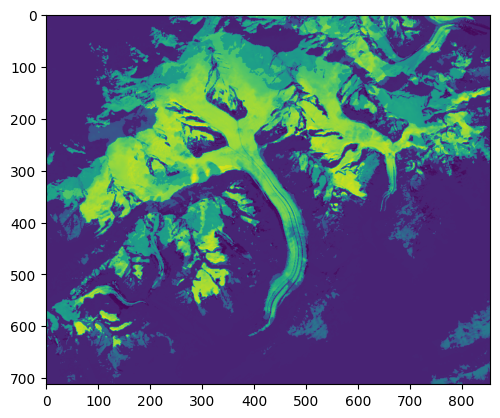

In [32]:
res = gpr.predict(np.array([2017, 10, 3]).reshape(1, -1)).reshape(712, 856)
plt.imshow(res)

In [11]:
# interpolate images
# create datetime vectors 

import datetime

dt = datetime.datetime(2013, 1, 1)
end = datetime.datetime(2022, 1, 1)
step = datetime.timedelta(days=1)

result = []

while dt < end:
    result.append(dt.strftime('%Y-%m-%d %H:%M:%S'))
    dt += step

In [12]:
result

['2013-01-01 00:00:00',
 '2013-01-02 00:00:00',
 '2013-01-03 00:00:00',
 '2013-01-04 00:00:00',
 '2013-01-05 00:00:00',
 '2013-01-06 00:00:00',
 '2013-01-07 00:00:00',
 '2013-01-08 00:00:00',
 '2013-01-09 00:00:00',
 '2013-01-10 00:00:00',
 '2013-01-11 00:00:00',
 '2013-01-12 00:00:00',
 '2013-01-13 00:00:00',
 '2013-01-14 00:00:00',
 '2013-01-15 00:00:00',
 '2013-01-16 00:00:00',
 '2013-01-17 00:00:00',
 '2013-01-18 00:00:00',
 '2013-01-19 00:00:00',
 '2013-01-20 00:00:00',
 '2013-01-21 00:00:00',
 '2013-01-22 00:00:00',
 '2013-01-23 00:00:00',
 '2013-01-24 00:00:00',
 '2013-01-25 00:00:00',
 '2013-01-26 00:00:00',
 '2013-01-27 00:00:00',
 '2013-01-28 00:00:00',
 '2013-01-29 00:00:00',
 '2013-01-30 00:00:00',
 '2013-01-31 00:00:00',
 '2013-02-01 00:00:00',
 '2013-02-02 00:00:00',
 '2013-02-03 00:00:00',
 '2013-02-04 00:00:00',
 '2013-02-05 00:00:00',
 '2013-02-06 00:00:00',
 '2013-02-07 00:00:00',
 '2013-02-08 00:00:00',
 '2013-02-09 00:00:00',
 '2013-02-10 00:00:00',
 '2013-02-11 00:

In [13]:
times = []
for i in range(len(result)):
    helper = str(result[i])
    year = int(helper[0:4])
    month = int(helper[5:7])
    day = int(helper[8:10])
    res = np.array([year, month, day])
    times.append(res)
    
dates = np.vstack(times)
print(dates)

[[2013    1    1]
 [2013    1    2]
 [2013    1    3]
 ...
 [2021   12   29]
 [2021   12   30]
 [2021   12   31]]


In [14]:
len(dates)

3287

In [ ]:
#feed into gaussian process, create synthetic data
d = []
for i in range(len(dates)):
    res = gpr.predict(np.array(dates[i]).reshape(1, -1)).reshape(712, 856)
    d.append(res)
    if i%100 == 0:
        print(i)


0
100
200
300
400
500
600
700


In [ ]:
snowPix = list(map(lambda x: np.sum(np.ndarray.flatten(d)), data))